In [1]:
import sys
sys.path.append('/Users/vdk/GeneveWork/Code/calibpipe-main-calibpipe/')
from astropy.io import ascii
import numpy as np
import pandas as pd
import matplotlib
import csv
import scipy
import matplotlib.pyplot as plt
import random
import copy
from os import path, makedirs
from astropy.coordinates import SkyCoord
from astropy.table import Table
import astropy.units as u
from ctapipe.containers import MuonEfficiencyContainer
from ctapipe.coordinates import CameraFrame, TelescopeFrame
from ctapipe.io import EventSource, EventSeeker
from ctapipe.core import TelescopeComponent
from ctapipe.core.traits import (
    List,
    Int,
    FloatTelescopeParameter,
    TelescopeParameter,
    Unicode,
)
from ctapipe.image.cleaning import tailcuts_clean
from ctapipe.image.muon import MuonRingFitter, MuonIntensityFitter
from traitlets.config import Config
from ctapipe.image import ImageProcessor
from ctapipe.image.muon import MuonProcessor
from ctapipe.visualization import CameraDisplay
from ctapipe.instrument import CameraGeometry
from ctapipe.calib import CameraCalibrator
from traitlets.config.loader import Config, FileConfigLoader, JSONFileConfigLoader
import pathlib
from calibpipe.throughput import MuonCalibrator

TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
3042.0909705320937


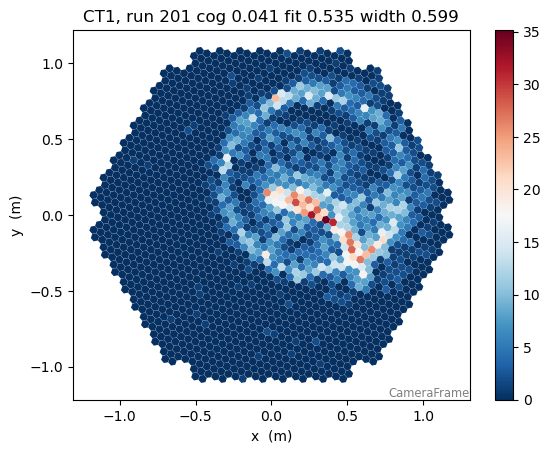

In [2]:
# TO FIND BIG WIDTH
filename = '/Users/vdk/GeneveWork/Code/calibpipe-main-calibpipe/calibpipe/tests/data/throughput/output/simtel_run201_muon.simtel.gz'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)


bad_events_obs2  = [1096, 876, 3649, 6122]
norm_events = [2402]
checker = 0
bad_eff_obs2= [254,  346,  382,  658,  876,  971,  999, 1096, 1537]

for i,j in enumerate(event_iterator):
    if i==1096:
        event664 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        #print("width = ", j.muon.tel[1].efficiency.width.to_value())
        plt.figure()
        camgeom = source.subarray.tel[1].camera.geometry
        title="CT{}, run {} cog {} fit {} width {}".format(1,j.index.obs_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        #disp.image = j.r0.tel[1].waveform[0].sum(axis=1)        
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        #plt.savefig(f"/Users/vdk/TrurImageCheckCOG{i}_COG=0_fitWrong")
        plt.show()
        event = j
        break
        #if i == 4000:
        #    break

plt.close()

In [3]:
# Sampling rate for MST
source.subarray.tel[1].camera.readout.sampling_rate.to_value(u.GHz)

1.024

TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2786.0305263146665
width =  0.07925006486960746


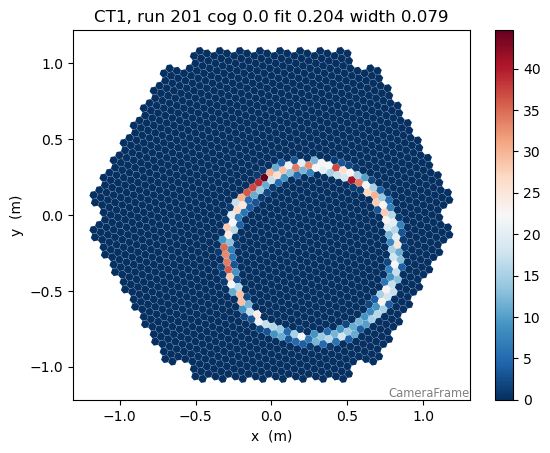

In [4]:
# TO FIND BIG WIDTH
filename = '/Users/vdk/GeneveWork/Code/calibpipe-main-calibpipe/calibpipe/tests/data/throughput/output/simtel_run201_muon.simtel.gz'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)


bad_events_obs2  = [1096, 876, 3649, 6122]
norm_events = [2402]
checker = 0
bad_eff_obs2= [254,  346,  382,  658,  876,  971,  999, 1096, 1537]

for i,j in enumerate(event_iterator):
    if i==664:
        event664 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        print("width = ", j.muon.tel[1].efficiency.width.to_value())
        plt.figure()
        camgeom = source.subarray.tel[1].camera.geometry
        title="CT{}, run {} cog {} fit {} width {}".format(1,j.index.obs_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        #disp.image = j.r0.tel[1].waveform[0].sum(axis=1)        
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        #plt.savefig(f"/Users/vdk/TrurImageCheckCOG{i}_COG=0_fitWrong")
        plt.show()
        #event = j
        break
        #if i == 4000:
        #    break

plt.close()

In [5]:
waveform_iterator = iter(event.r0.tel[1].waveform)

In [6]:
a = next(waveform_iterator)

In [7]:
a[100]

array([384, 377, 387, 401, 385, 386, 394, 376, 394, 416, 444, 525, 568,
       563, 524, 514, 486, 457, 437, 402, 411, 418, 411, 415, 426, 420,
       440, 422, 413, 409, 429, 424, 410, 398, 419, 401, 395, 388, 398,
       397], dtype=uint16)

TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2536.872568390131
width =  0.07190916070560345
(1855, 40)
False
2160.2496172447704
width =  0.29261856483710075


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2838.0936595826106
width =  0.08496341557370571


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3144.9814304133984
width =  0.06373981103659368


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2037.8918300584235
width =  0.08441988266248464


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2949.2416405834074
width =  0.09959276857015754


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3070.8392665037586
width =  0.07277392864139072


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1475.7833659362045
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2272.8488775850738
width =  0.10157635442643817


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3076.7969122777704
width =  0.08576991719906656


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2208.831950554868
width =  0.07684178718987654


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2749.872118351157
width =  0.09899918626800691


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3138.298545391818
width =  0.08290907400836138


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2775.034756519564
width =  0.07166122805992907


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3140.39932065644
width =  0.06908930628097232


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
width =  nan
(1855, 40)
False
2515.8189757230384
width =  0.06662952743927018


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2286.437904122999
width =  0.0849780158010306


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1003.0025691594061
width =  0.18550260848955055
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2587.1794529465647
width =  0.09143426584066122
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
/var/folders/_p/3fmt5jz5231_9gxtm8xt76p00000gn/T/ipykernel_52775/490003322.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


False
3247.6473341787164
width =  0.06447762677277859


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3047.3265525798197
width =  0.059478599343424844


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2619.0411730477763
width =  0.07445414022388691


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2978.2361278729986
width =  0.07277762071709916


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3004.9266448466724
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2144.490968026283
width =  0.07349298362288204


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2894.381153330829
width =  0.06280950114998533


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2225.7606230756455
width =  0.08345680039668343


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2489.3517340298467
width =  0.10525300721260897


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3139.259458780756
width =  0.07657693612445925


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3306.0801307248876
width =  0.08148975403249953


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3149.697628760375
width =  0.067019855027614


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2639.144947707072
width =  0.08078224513944107


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3807.447942124676
width =  0.07154855476169543


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2851.9527099483807
width =  0.07370391527554274


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3146.5786291215645
width =  0.0705697694486114


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1753.6934307826414
width =  0.10371697993368632


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3207.1081943204426
width =  0.07388819062439515


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3475.2018749673402
width =  0.07958505689504236


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3427.926403580737
width =  0.08532812407294864


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2674.3140750428292
width =  0.09112109552301043


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1993.1685705850166
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2537.8849791216307
width =  0.06898145714247238


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2274.445468339336
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2242.474497297808
width =  0.08139458101162857


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2644.233737251322
width =  0.10980928803040985


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2972.344324878607
width =  0.0698232405565925


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2417.6922581826257
width =  0.07714494783193512


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3289.080644188197
width =  0.08757709276571814


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
True
3472.914005914944
width =  0.0941016016241581


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2234.020547077363
width =  0.0698577778557425


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3077.8602359457655
width =  0.09745503548857236


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2236.4288008171357
width =  0.100360610492553


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2728.99147699336
width =  0.07980582639993526


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2651.787062095787
width =  0.06968028214627049


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2930.8339194256155
width =  0.07230414933432869


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3324.5515823271844
width =  0.07017262765642546


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2085.804181027158
width =  0.08139951819933193


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3062.0672414997935
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2521.8906270197117
width =  0.12178125122081797


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1504.0451636497096
width =  0.18152575162688955


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2480.1290405388672
width =  0.06984416579487526


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1807.6703244959913
width =  0.06285170789684148


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2065.1923120076026
width =  0.08242406149122819


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3353.452801335276
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1627.6800755237578
width =  0.10182958501348005


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
True
1803.7185645904246
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
True
3071.2680384867017
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2992.4536041924953
width =  0.05614153456909902


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1057.0580004959916
width =  0.20446994069497382
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2460.409414120003
width =  nan
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2345.456113103335
width =  nan
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2815.8411076825732
width =  0.058517467147579376
(1855, 40)
True
1940.1239632729516
width =  0.09165658544643344


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3171.670116237014
width =  0.07328968773180775


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3041.2866282087607
width =  0.06565381496224879


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2654.855725950771
width =  0.22391205900338276
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
TelescopeParameter type argument 'MST_*' did not match any known telescope types


False
3320.3072613696604
width =  0.06696470806213237
(1855, 40)


TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
1935.865911929859
width =  0.1001344122643522
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2909.4534756500507
width =  0.19031652238280292
(1855, 40)
False
2321.1102105177147
width =  0.14599680788640787


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
width =  nan
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
3331.8922442064836
width =  0.0724262566042211


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2940.7713272822707
width =  0.09133893095540851


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
True
4025.6501085792297
width =  0.10585363226030992


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2627.539829230369
width =  nan


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2880.3974751347355
width =  0.06730400101495004


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2614.8553995567167
width =  0.08455696755874811


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
1485.8835818401412
width =  0.07740393199400045


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2316.896421027909
width =  0.06695701648874491


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3277.755995731013
width =  0.06809810875716568


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2630.258887346973
width =  0.07025118581041748


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2840.500155286735
width =  0.08139970749267729


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
width =  nan
(1855, 40)


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types
TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


width =  nan
(1855, 40)
False
2985.0253263530844
width =  0.06973170883563015


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3063.3346105484566
width =  0.07791019181972415


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3220.7979369746513
width =  0.08282543346648245


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
2562.0750311120282
width =  0.08618859089492173


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
True
3837.1056345777592
width =  0.0885993555289178


TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


(1855, 40)
False
3123.9267746030796
width =  0.08371925704071799
(1855, 40)


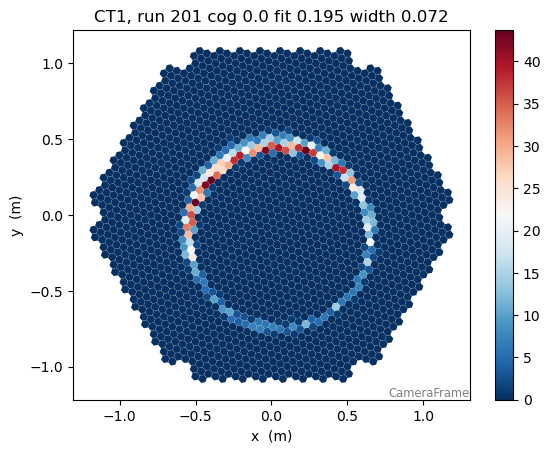

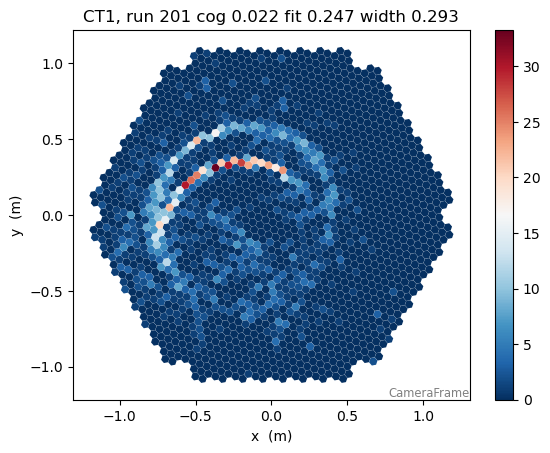

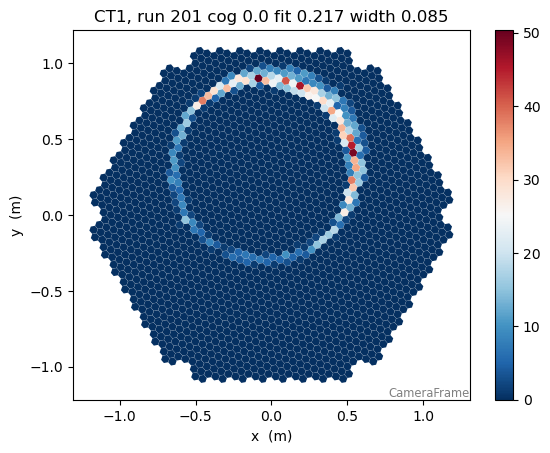

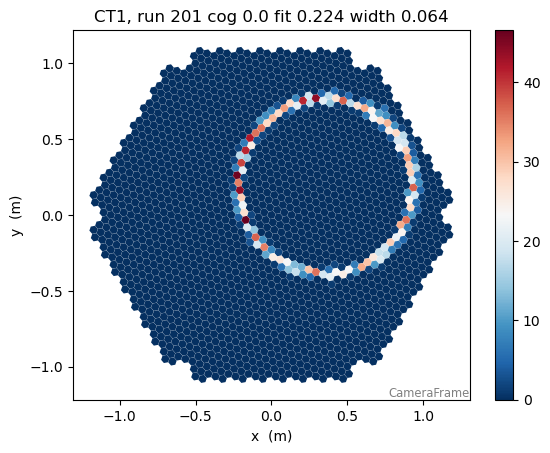

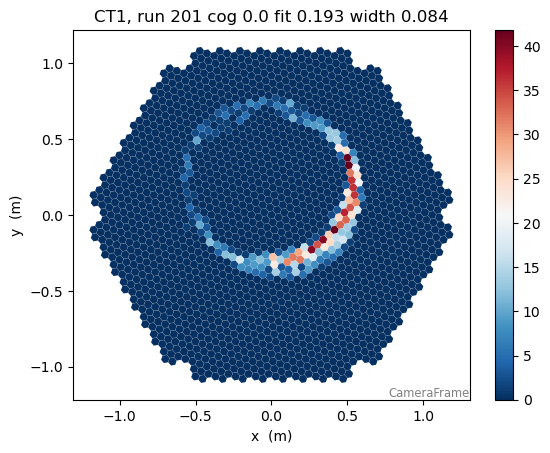

...

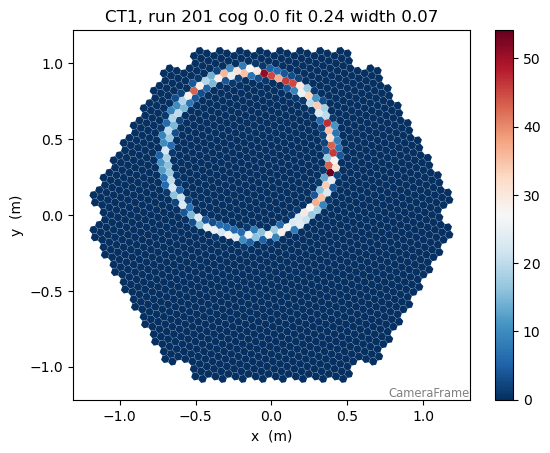

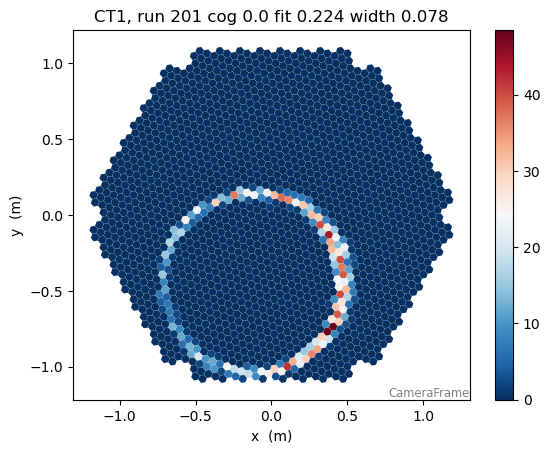

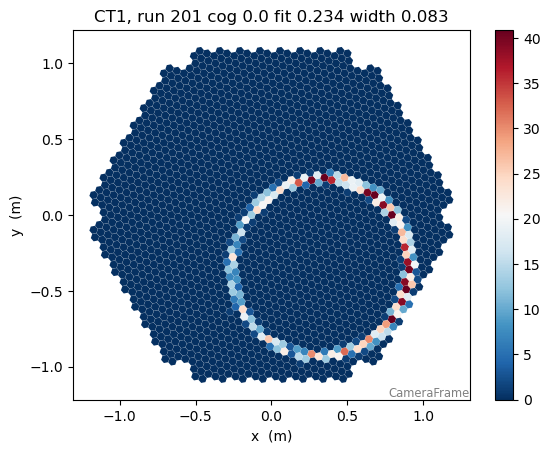

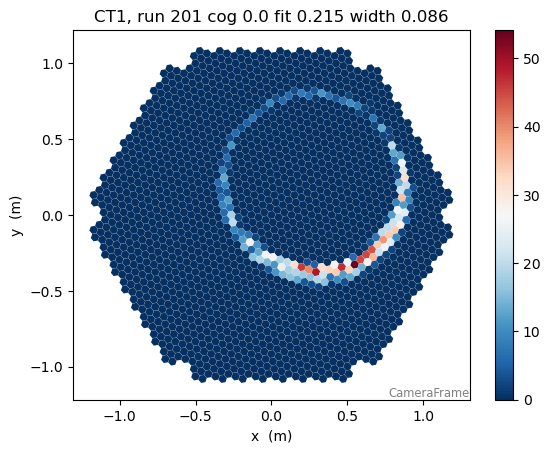

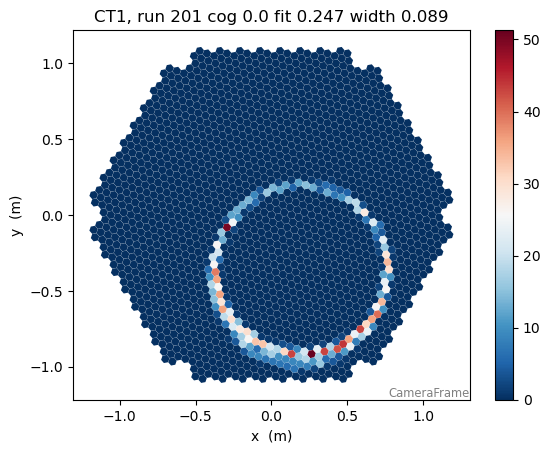

In [8]:
# TO FIND BIG WIDTH
filename = '/Users/vdk/GeneveWork/Code/calibpipe-main-calibpipe/calibpipe/tests/data/throughput/output/simtel_run201_muon.simtel.gz'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)


bad_events_obs2  = [1096, 876, 3649, 6122]
norm_events = [2402]
checker = 0
bad_eff_obs2= [254,  346,  382,  658,  876,  971,  999, 1096, 1537]

for i,j in enumerate(event_iterator):
    if i<201:
        event2 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        print("width = ", j.muon.tel[1].efficiency.width.to_value())
        plt.figure()
        camgeom = source.subarray.tel[1].camera.geometry
        title="CT{}, run {} cog {} fit {} width {}".format(1,j.index.obs_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        #plt.savefig(f"/Users/vdk/TrurImageCheckCOG{i}_COG=0_fitWrong")
        #plt.show()
        print(j.r1.tel[1].waveform.shape)
        #break
        if i == 100:
            break

plt.close()

In [9]:
event2.r1.tel[1].waveform.shape

(1855, 40)

In [10]:
event.index.event_id

110100

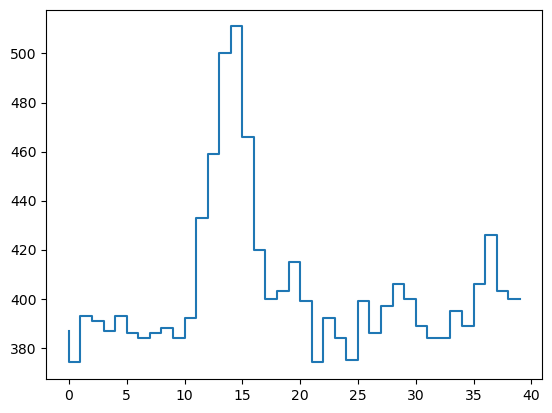

In [11]:
teldata = event.r0.tel[1]
trace = teldata.waveform[0][7]
plt.plot(trace, drawstyle='steps')

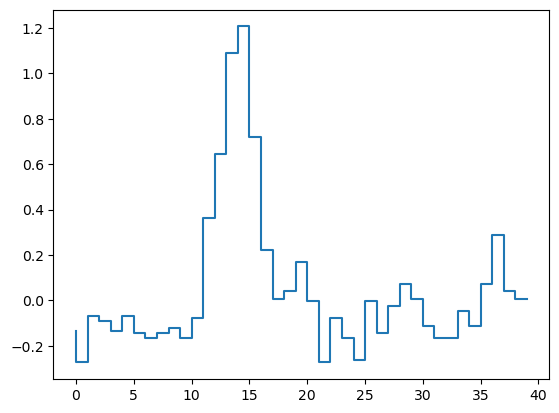

In [12]:
teldata = event.r1.tel[1]
trace = teldata.waveform[7]
plt.plot(trace, drawstyle='steps')

IndexError: index 40 is out of bounds for axis 0 with size 40

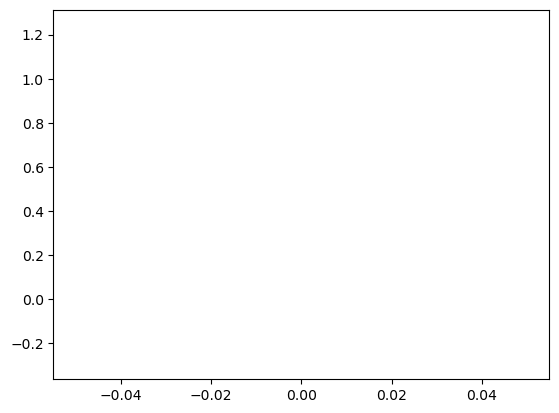

In [13]:
for pix_id in range(1,1855):
    plt.plot(teldata.waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
#plt.legend()

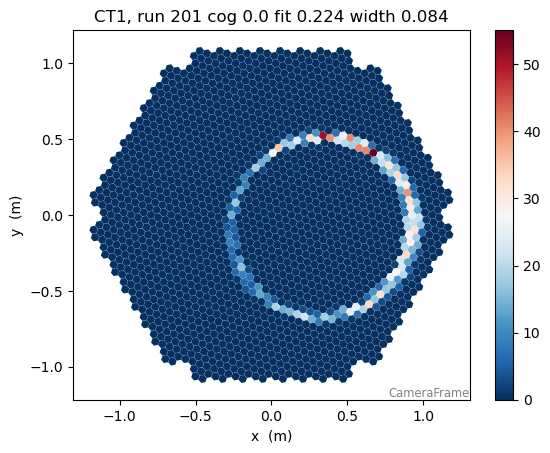

In [14]:
plt.figure()
camgeom = source.subarray.tel[1].camera.geometry
#title="CT{}, run {} cog {} fit {} width {}".format(1,event.index.obs_id, round(event.dl1.tel[1].parameters.concentration.cog, 3), round(event.muon.tel[1].efficiency.optical_efficiency, 3), round(event.muon.tel[1].efficiency.width.to_value(),3))
disp = CameraDisplay(camgeom,title=title)
disp.image = event2.simulation.tel[1].true_image #.sum(axis=1)
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
plt.show()

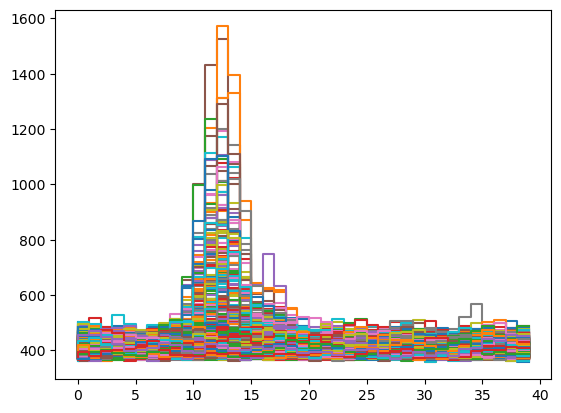

In [15]:
teldata = event2.r0.tel[1]
for pix_id in range(0,1855):
    plt.plot(teldata.waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
#plt.legend()

waveform[0] is an array of shape (N_pix,N_slice) = (1855, 40)


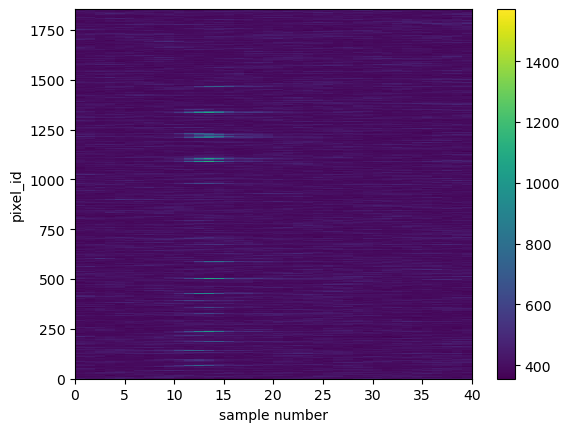

In [16]:
plt.pcolormesh(teldata.waveform[0])
plt.colorbar()
plt.ylim(0,1855)
plt.xlabel("sample number")
plt.ylabel("pixel_id")
print("waveform[0] is an array of shape (N_pix,N_slice) =",teldata.waveform[0].shape)

waveform[0] is an array of shape (N_pix,N_slice) = (1855, 40)


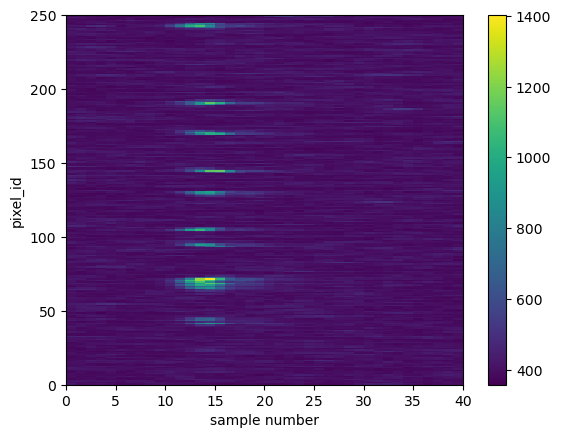

In [17]:
teldata2 = event.r0.tel[1]
plt.pcolormesh(event664.r0.tel[1].waveform[0])
plt.colorbar()
plt.ylim(0,250)
plt.xlabel("sample number")
plt.ylabel("pixel_id")
print("waveform[0] is an array of shape (N_pix,N_slice) =",teldata2.waveform[0].shape)

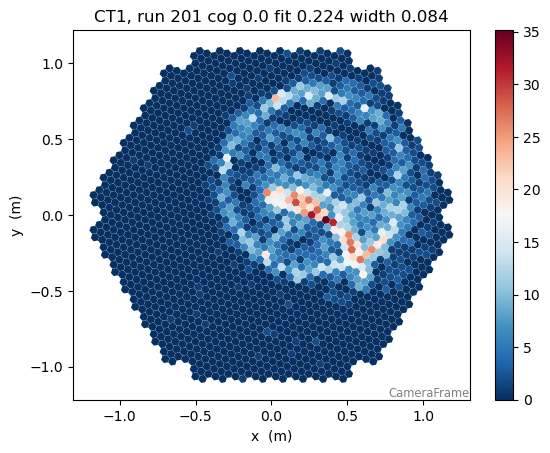

In [18]:
plt.figure()
camgeom = source.subarray.tel[1].camera.geometry
#title="CT{}, run {} cog {} fit {} width {}".format(1,event.index.obs_id, round(event.dl1.tel[1].parameters.concentration.cog, 3), round(event.muon.tel[1].efficiency.optical_efficiency, 3), round(event.muon.tel[1].efficiency.width.to_value(),3))
disp = CameraDisplay(camgeom,title=title)
disp.image = event.simulation.tel[1].true_image #.sum(axis=1)
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
plt.show()

In [19]:
filename = '/Users/vdk/GeneveWork/Code/calibpipe-main-calibpipe/calibpipe/tests/data/throughput/output/simtel_run201_muon.simtel.gz'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 501:
        event_test = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} event {} fit efficiency {} width {}".format(j.index.obs_id, j.index.event_id, round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms per pixel")
        #plt.show()
        plt.savefig(f"/Users/vdk/TrueImage+Waveform_event{j.index.event_id}_obs{j.index.obs_id}")
        break
        #if i == 4000:
        #    break

plt.close()

TelescopeParameter type argument 'MST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2016.5957737144581


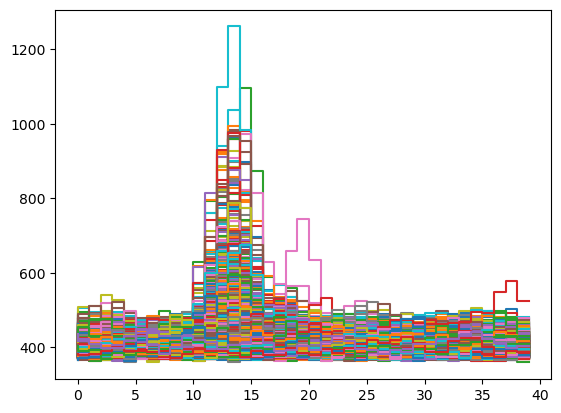

In [20]:
for pix_id in range(0,1855):
    plt.plot(event.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)

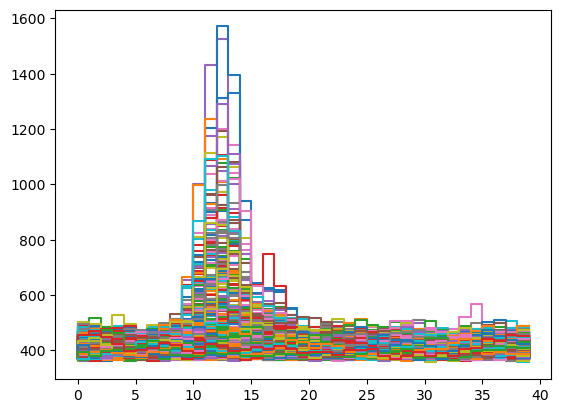

In [21]:
for pix_id in range(1,1855):
    plt.plot(event2.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)
#plt.legend()

In [22]:
for pix_id in range(1,1855):
    plt.plot(event3.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)
#plt.legend()

NameError: name 'event3' is not defined

In [ ]:
for pix_id in range(60,90):
    plt.plot(event664.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)
#plt.legend()

In [ ]:
for pix_id in range(0,1855):
    plt.plot(event5.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)
#plt.legend()

In [ ]:
for pix_id in range(0,1855):
    plt.plot(event6087.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)
#plt.legend()

MST PROCESSING

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
1839.9901253840408


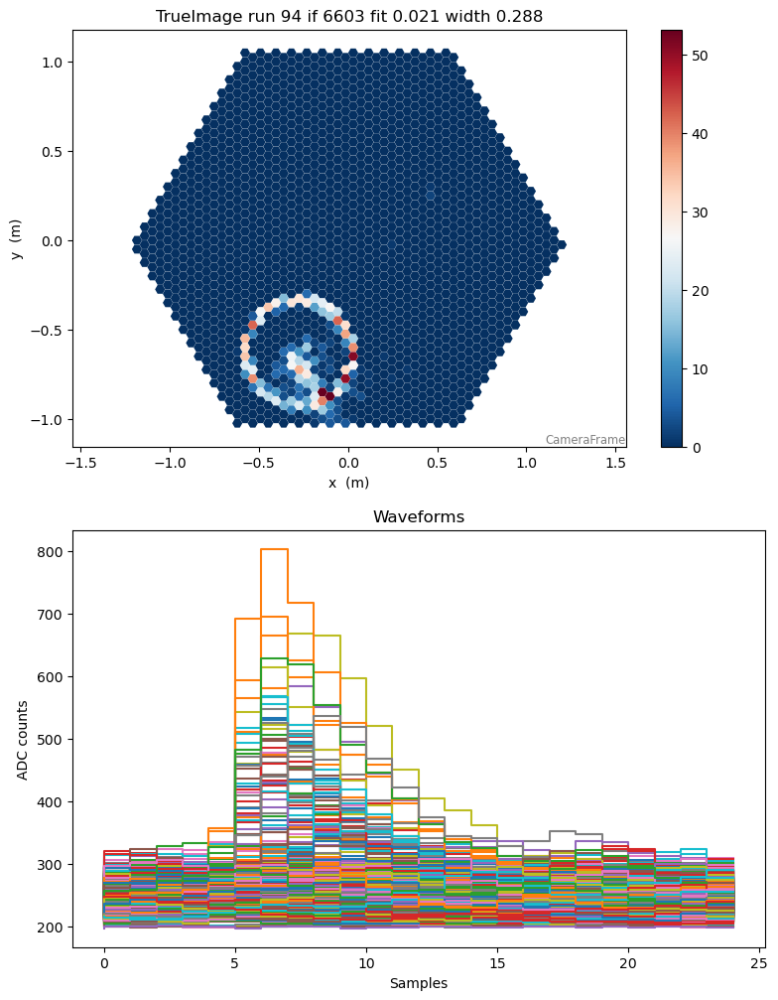

In [23]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 2:
        event_mst2 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        break
        #if i == 4000:
        #    break

plt.close()

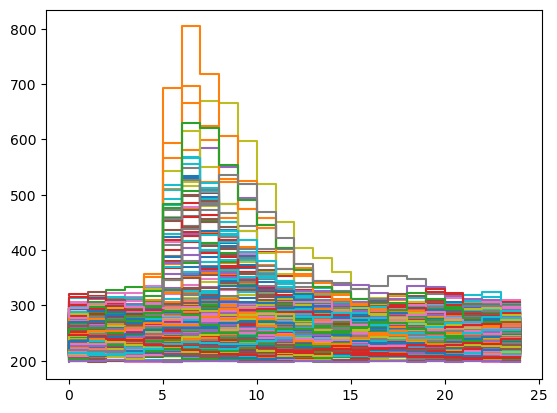

In [24]:
for pix_id in range(0,1764):
    plt.plot(event_mst2.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
1769.4771872741776


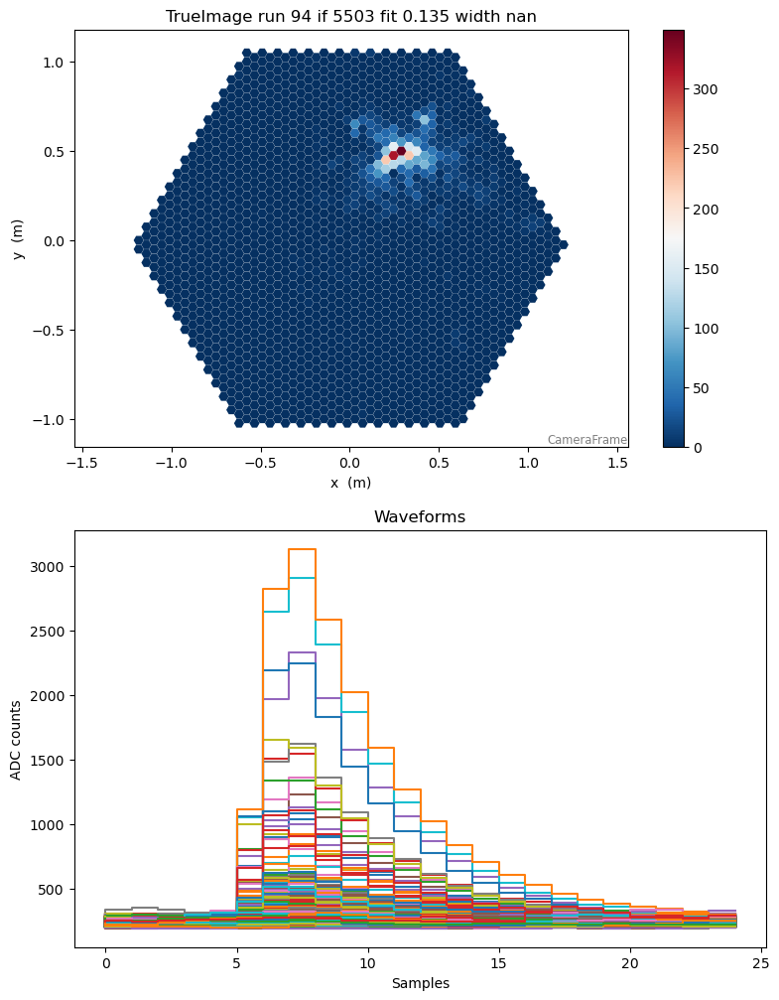

In [25]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 1:
        event_mst1 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        break
        #if i == 4000:
        #    break

plt.close()

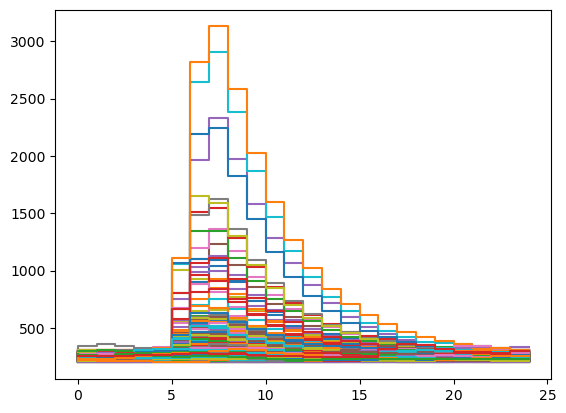

In [26]:
for pix_id in range(0,1764):
    plt.plot(event_mst1.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
6085.447765949488


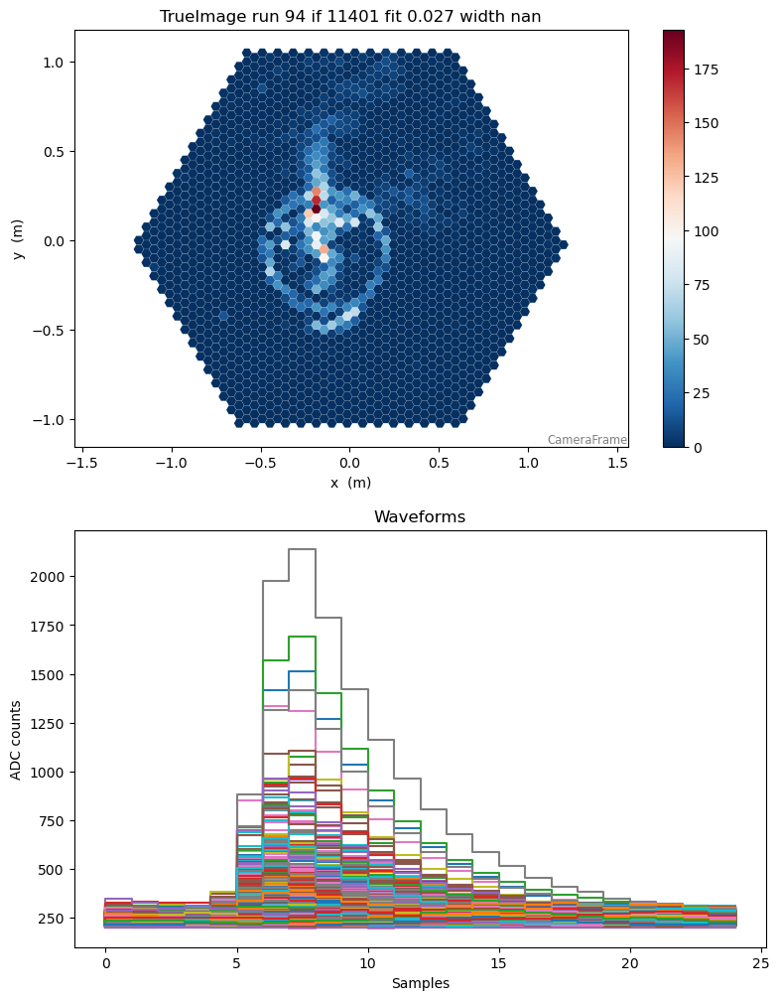

In [27]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 4:
        event_mst4 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        break
        #if i == 4000:
        #    break

plt.close()

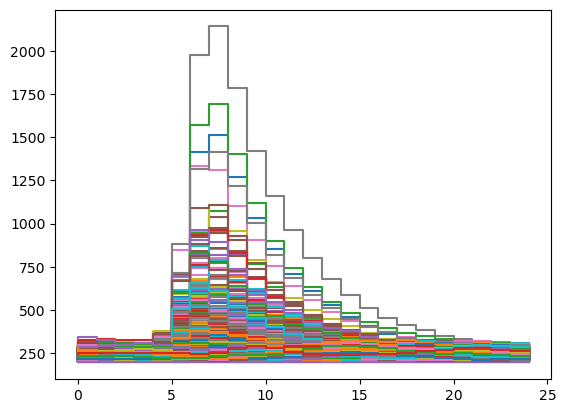

In [28]:
for pix_id in range(0,1764):
    plt.plot(event_mst4.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
1839.9901253840408


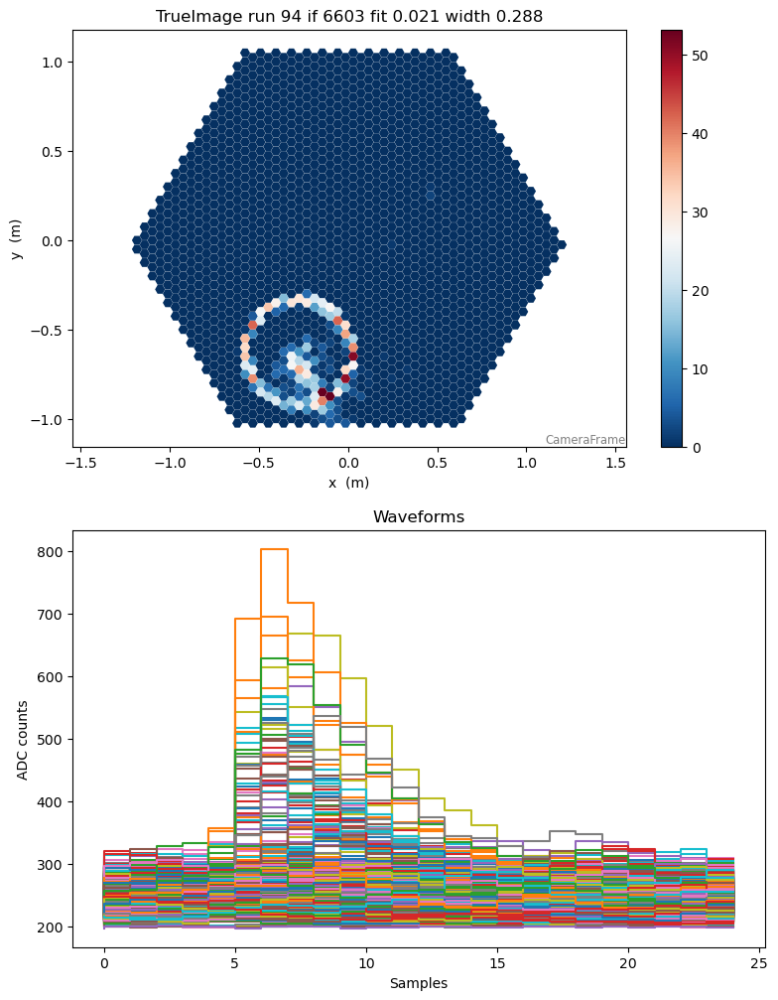

In [34]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 2:
        event_mst8 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        break
        #if i == 4000:
        #    break

plt.close()

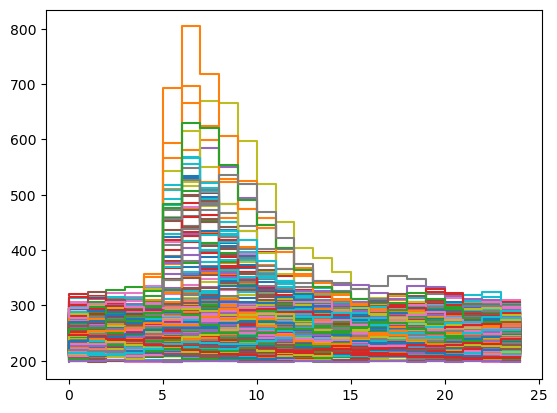

In [35]:
for pix_id in range(0,1764):
    plt.plot(event_mst8.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2636.7256640217297


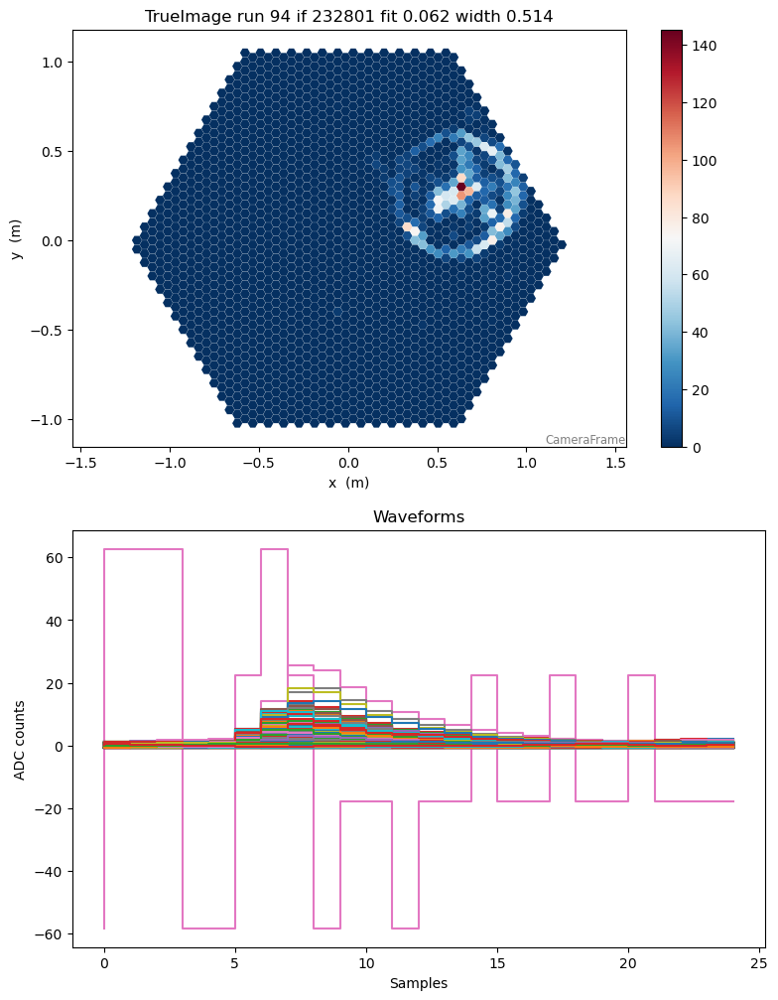

In [36]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)


# event 9 in proton run2 is muon ring

for i,j in enumerate(event_iterator):
    if i == 110:
        event_mst9 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        #print("width = ", j.muon.tel[1].efficiency.width.to_value())
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            #bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
            bx.plot(j.dl0.tel[1].waveform[pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        #bx.set_ylim()
        plt.show()
        #plt.savefig(f"/Users/vdk/TrueImage+Waveform_mstPROTON_event{j.index.event_id}_obs{j.index.obs_id}")
        break
        #if i == 4000:
        #    break

plt.close()

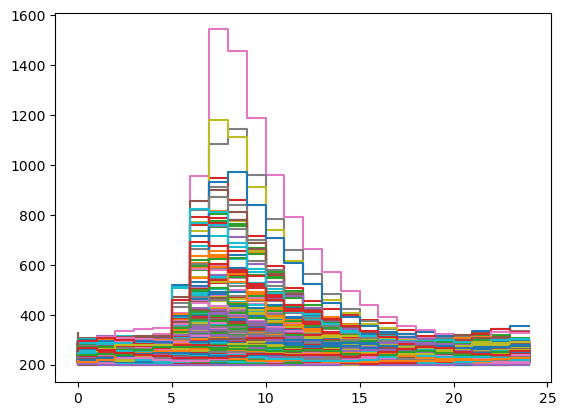

In [37]:
for pix_id in range(0,1764):
    plt.plot(event_mst9.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(500,1200)

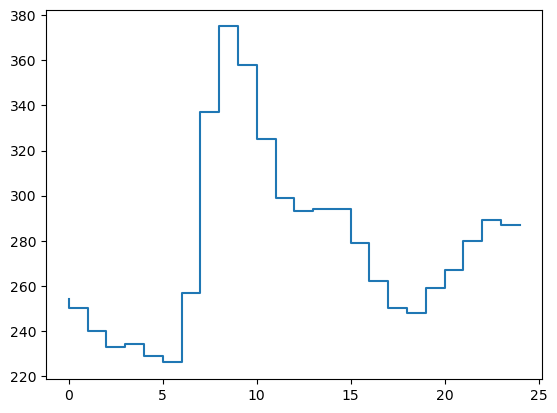

In [38]:
plt.plot(event_mst9.r0.tel[1].waveform[0][700], label="pix {}".format(pix_id), drawstyle='steps')

In [39]:
event_mst9.r0.tel[1].waveform[0,1]

array([226, 221, 220, 218, 227, 233, 244, 264, 266, 262, 262, 278, 277,
       268, 267, 269, 268, 259, 261, 270, 274, 270, 258, 246, 241],
      dtype=uint16)

In [40]:
from ipywidgets import interact

brightest_pixel = np.argmax(event_mst9.r0.tel[1].waveform[0].sum(axis=1))

@interact
def view_waveform(chan=0, pix_id=brightest_pixel):
    plt.plot(event_mst9.r0.tel[1].waveform[chan, pix_id])
    plt.ylim(0,700)

interactive(children=(IntSlider(value=0, description='chan', max=1), IntSlider(value=696, description='pix_id'…

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


False
2008.6033836702134


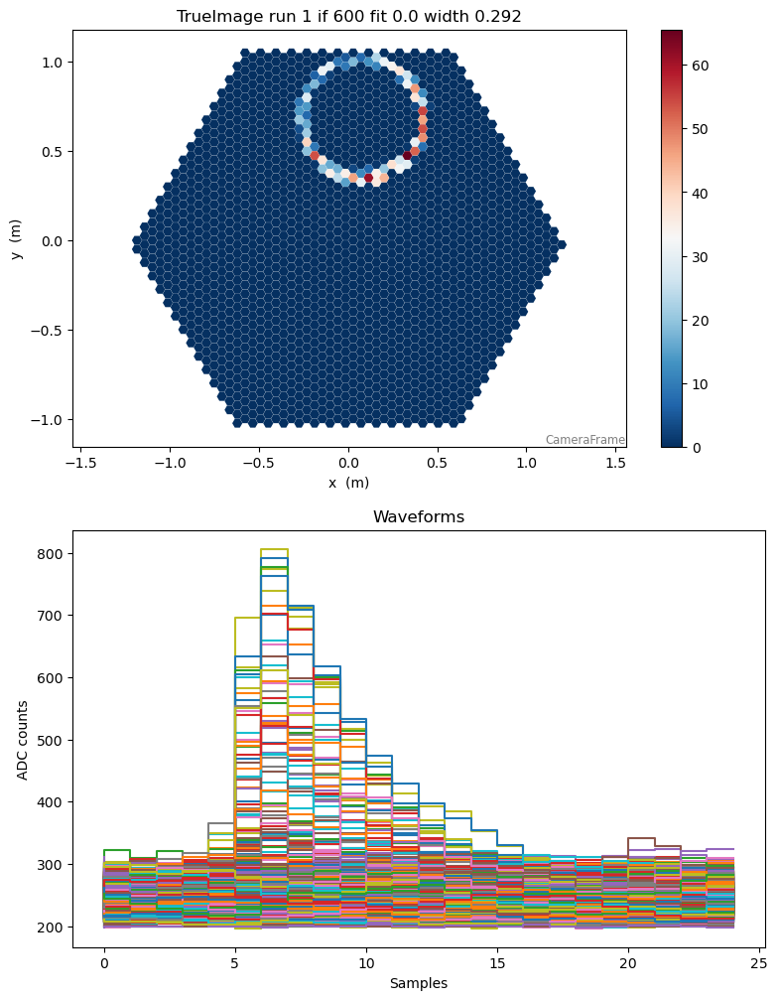

In [41]:
filename = '/Users/vdk/MST_work/data_muons/mono_muon_simtel/muon_20deg_0deg_run0___cta-prod6-paranal-2147m-Paranal-0-LSTs-1-MSTs-0-SSTs-NSCAT_1_CSCAT_8_EMIN_0.005_EMAX_1_FIXCHI_600_VIEWCONE_3_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 2:
        event_mst2 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="GlobalPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.dl1.tel[1].parameters.concentration.cog, 3), round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        #bx.set_ylim(0,50)
        plt.show()
        #plt.savefig(f"/Users/vdk/TrueImage+Waveform_mstMUON_event{j.index.event_id}_obs{j.index.obs_id}")
        break
        #if i == 4000:
        #    break
        
plt.close()

In [42]:
event_mst9

ctapipe.containers.ArrayEventContainer:
                       index.*: event indexing information with default None
                          r0.*: Raw Data with default None
                          r1.*: R1 Calibrated Data with default None
                         dl0.*: DL0 Data Volume Reduced Data with default None
                         dl1.*: DL1 Calibrated image with default None
                         dl2.*: DL2 reconstruction info with default None
                  simulation.*: Simulated Event Information with default None
                                with type <class
                                'ctapipe.containers.SimulatedEventContainer'>
                     trigger.*: central trigger information with default None
                         count: number of events processed with default 0
                    pointing.*: Array and telescope pointing positions with
                                default None
                 calibration.*: Container for calibra

In [43]:
event_mst9.muon.tel[1]

ctapipe.containers.MuonTelescopeContainer:
                        ring.*: muon ring fit with default None
                  parameters.*: muon parameters with default None
                  efficiency.*: muon efficiency with default None

In [44]:
teldata = event.r0.tel[1]

Text(0, 0.5, 'Pixel_id')

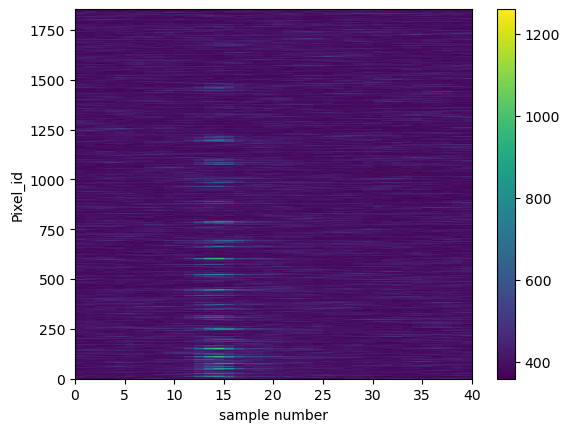

In [45]:
plt.pcolormesh(teldata.waveform[0])  # note the [0] is for channel 0
plt.colorbar()
plt.xlabel("sample number")
plt.ylabel("Pixel_id")

waveform[0] is an array of shape (N_pix,N_slice) = (1855, 40)


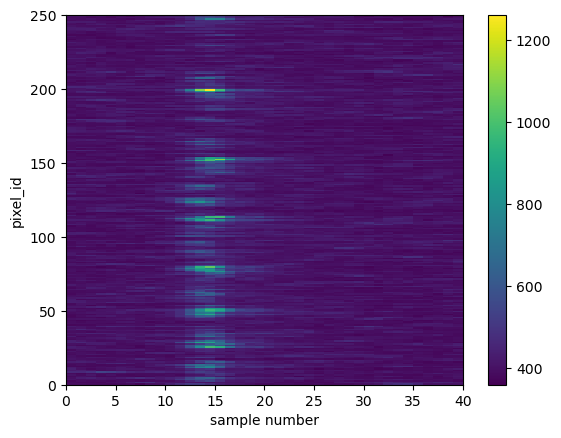

In [46]:
plt.pcolormesh(teldata.waveform[0])
plt.colorbar()
plt.ylim(0,250)
plt.xlabel("sample number")
plt.ylabel("pixel_id")
print("waveform[0] is an array of shape (N_pix,N_slice) =",teldata.waveform[0].shape)

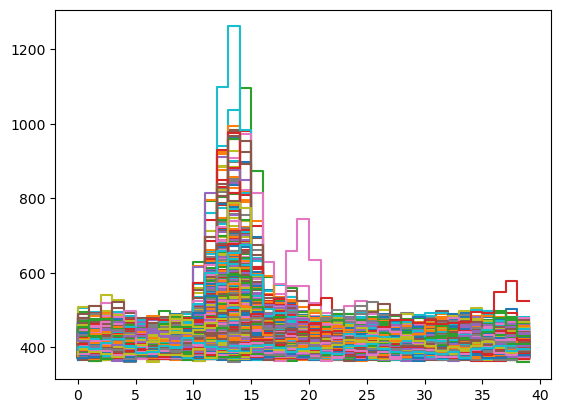

In [47]:
for pix_id in range(0,1850):
    plt.plot(teldata.waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
#plt.legend()

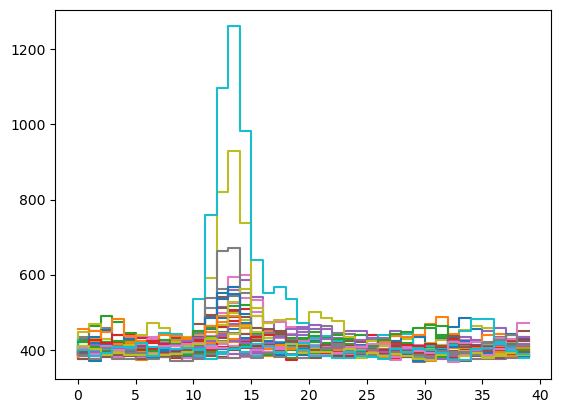

In [48]:
for pix_id in range(180,220):
    plt.plot(teldata.waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
#plt.legend()

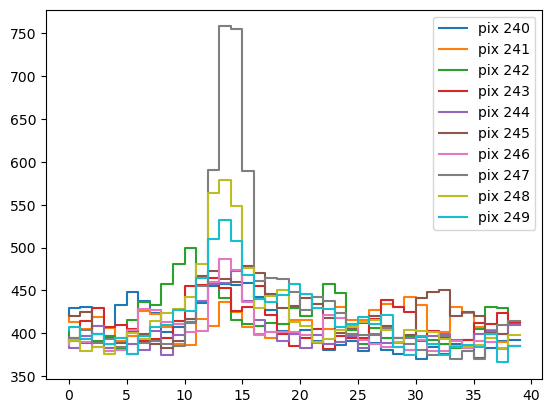

In [49]:
for pix_id in range(240,250):
    plt.plot(teldata.waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
plt.legend()

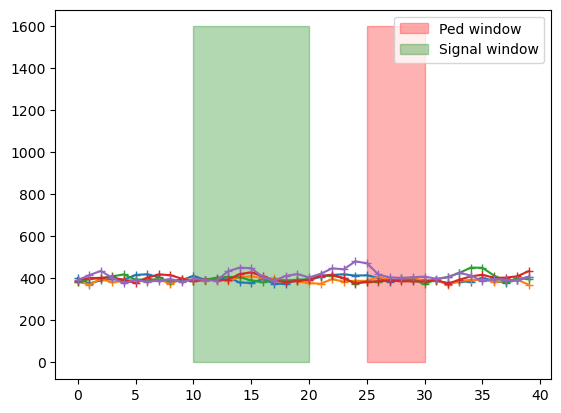

In [50]:
for pix_id in range(718,723):
    plt.plot(teldata.waveform[0][pix_id],'+-')
plt.fill_betweenx([0,1600],30,25,color='red',alpha=0.3, label='Ped window')
plt.fill_betweenx([0,1600],10,20,color='green',alpha=0.3, label='Signal window')
plt.legend()

In [51]:
data = teldata.waveform[0]
peds = data[:, 19:24].mean(axis=1)  # mean of samples 20 to 29 for all pixels
sums = data[:, 5:9].sum(axis=1)/(13-8)

Text(0, 0.5, 'Pedestal-subtracted Signal')

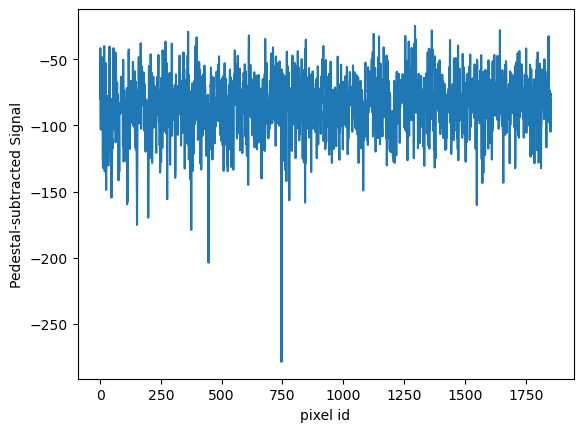

In [52]:
plt.plot(sums - peds)
plt.xlabel("pixel id")
plt.ylabel("Pedestal-subtracted Signal")

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


ImageExtractor
False
2330.155342906259


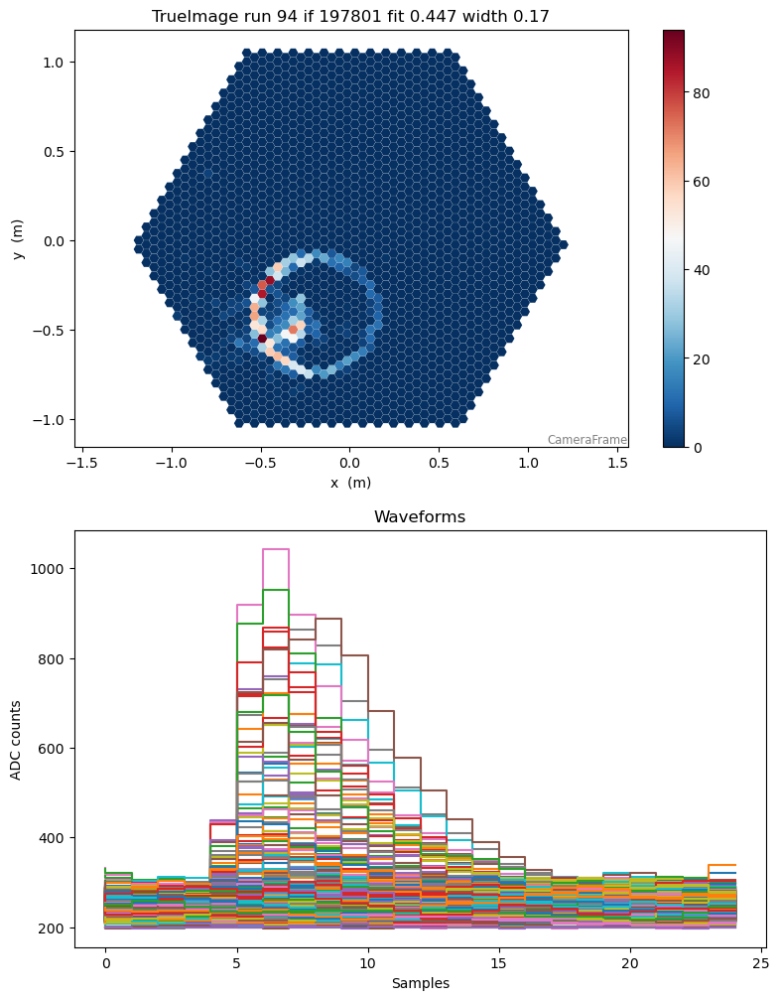

In [53]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
#filename = '/Users/vdk/MST_work/data_muons/mono_muon_simtel/muon_20deg_0deg_run0___cta-prod6-paranal-2147m-Paranal-0-LSTs-1-MSTs-0-SSTs-NSCAT_1_CSCAT_8_EMIN_0.005_EMAX_1_FIXCHI_600_VIEWCONE_3_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 93:
        event = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="NeighborPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        #disp.image = event.dl1.tel[1].image
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        #plt.savefig(f"/Users/vdk/MST_ProtonImages_NewQualityCheck/TrueImage+Waveform_mstPROTON_event{j.index.event_id}_obs{j.index.obs_id}_numer{i}")
        #plt.savefig(f"/Users/vdk/TrueImage+Waveform_mstMUON_event{j.index.event_id}_obs{j.index.obs_id}")
        break
        #if i == 150:
        #    break

plt.close()

In [54]:
# Sampling rate for MST
source.subarray.tel[1].camera.readout.sampling_rate.to_value(1/u.s)
source.subarray.tel[1].camera.geometry.neighbor_matrix_sparse
min(event.dl1.tel[1].peak_time)

-0.894746

Text(0, 0.5, 'Pixel_id')

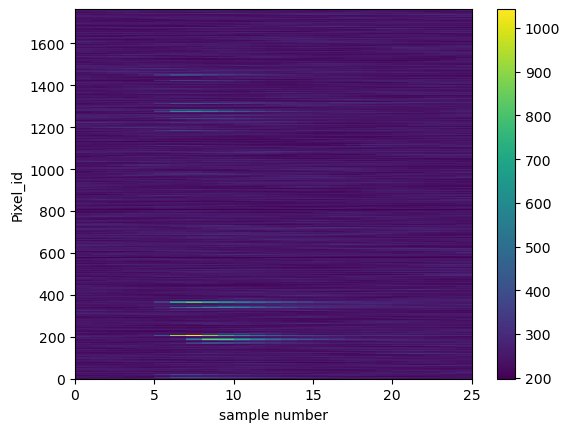

In [55]:
plt.pcolormesh(event.r0.tel[1].waveform[0])  # note the [0] is for channel 0
plt.colorbar()
plt.xlabel("sample number")
plt.ylabel("Pixel_id")

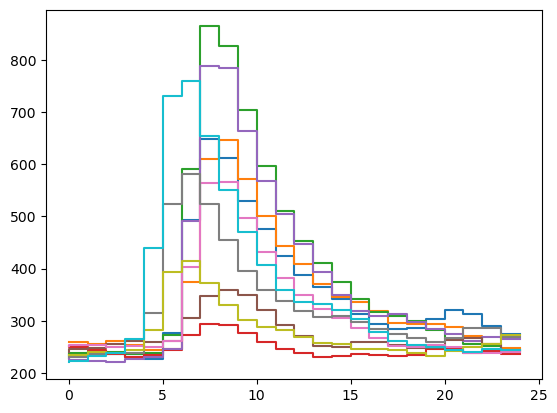

In [56]:
for pix_id in range(185,195):
    plt.plot(event.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
#plt.legend()

In [57]:
test_image = np.zeros((1764,25))
test_true_image = np.zeros(1764)
edit_image = event.simulation.tel[1].true_image.copy()
edit_image.shape

(1764,)

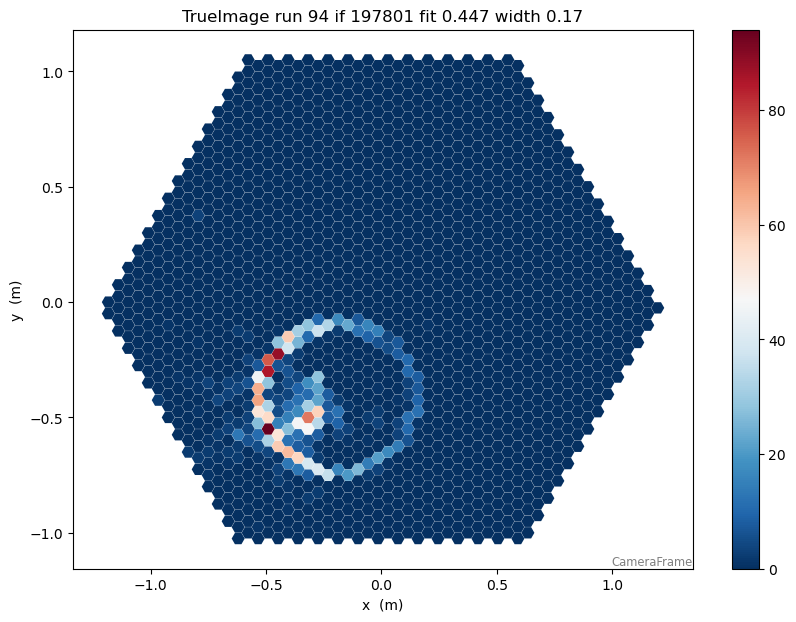

In [58]:
plt.figure(figsize = (10,7))
camgeom = source.subarray.tel[1].camera.geometry
#title="CT{}, run {} event {}".format(tel,event.index.obs_id,event.index.event_id)
disp = CameraDisplay(camgeom,title=title)
disp.image = event.simulation.tel[1].true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)

In [59]:
edit_image = event.simulation.tel[1].true_image.copy()
true_image = event.simulation.tel[1].true_image
# INDICES for central contamination of event 93 from obs94 protonMST file
indices1 = [i for i in range(160,175)]
indices2 = [i for i in range(1243, 1260)]
indices3 = [i for i in range(180,192)]
indices4 = [i for i in range(196,200)]
indices = indices1+indices2+indices3+indices4
#np.put(edit_image, indices1, [0])
#np.put(edit_image, indices2, [0])
#np.put(edit_image, indices3, [0])
np.put(edit_image, indices, [0])

In [60]:
cont_image =  event.simulation.tel[1].true_image.copy()
ind = [i for i in range(1764)]
cont_ind = list(set(ind)-set(indices))
np.put(cont_image, cont_ind, [0]) 

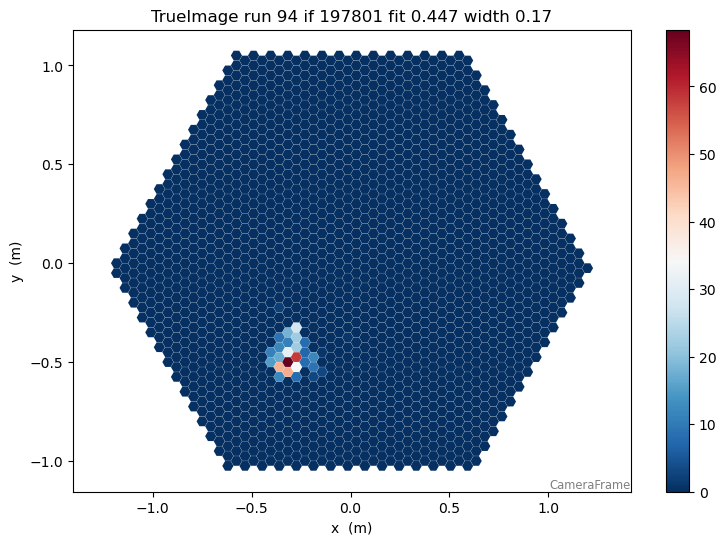

In [61]:
plt.figure(figsize = (9,6))
camgeom = source.subarray.tel[1].camera.geometry
#title="CT{}, run {} event {}".format(tel,event.index.obs_id,event.index.event_id)
disp = CameraDisplay(camgeom,title=title)
#disp.image = edit_image
disp.image = cont_image
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)

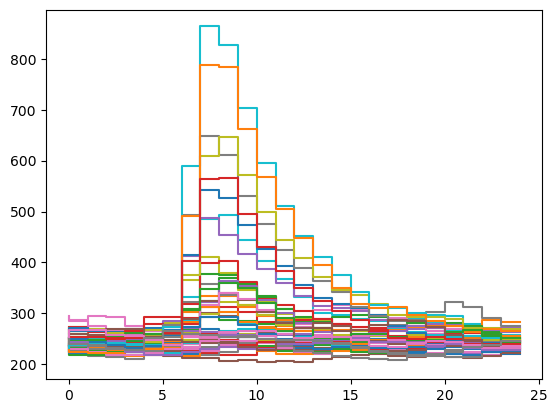

In [62]:
# only contamination region
for pix_id in indices:
    plt.plot(event.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(320,1000)
#plt.legend()

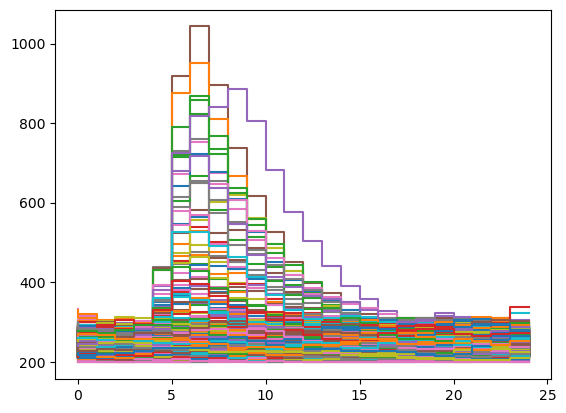

In [63]:
for pix_id in range(0,1760):
    if pix_id in indices:
        continue
    else:
        plt.plot(event.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
    #plt.ylim(320,1000)
#plt.legend()

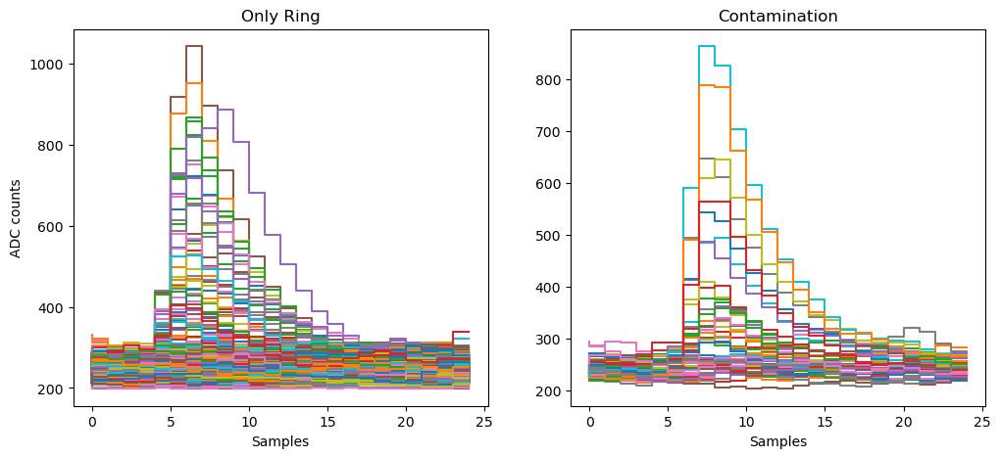

In [64]:
fig, axes = plt.subplots(1, 2, sharex=False, gridspec_kw={'width_ratios': [1, 1]}, figsize=(12,5))
fig.subplots_adjust(hspace=0.2)
ax = axes[0]
for pix_id in range(0,1760):
    if pix_id in indices:
        continue
    else:
        ax.plot(event.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
ax.set_ylabel("ADC counts")
ax.set_xlabel("Samples")
ax.set_title("Only Ring")
#ax.set_ylim(320,1100)
bx = axes[1]
for pix_id in indices:
    plt.plot(event.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
#bx.set_ylabel("ADC counts")
#bx.set_ylim(320,1100)
bx.set_xlabel("Samples")
bx.set_title("Contamination")
plt.show()
#plt.savefig("/Users/vdk/WaveformsRingContaminationWithBackground")

In [1]:
contaminated_waveform = np.array([])
test_w = []
for pix_id in indices:
    #np.append(contaminated_waveform, event.r0.tel[1].waveform[0][pix_id], axis = 0)
    test_w.append(event.r0.tel[1].waveform[0][pix_id])

#contaminated_waveform
#indices
#event.r0.tel[1].waveform[0][165]
np.argmax(test_w, axis = 0)
#test_w[2]

NameError: name 'np' is not defined

Text(0.5, 1.0, 'Extracted contamination')

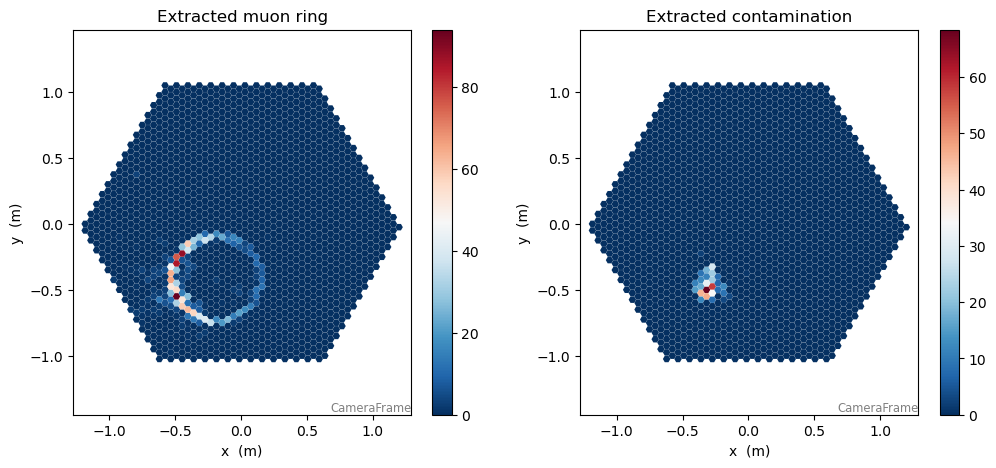

In [66]:
fig, axes = plt.subplots(1, 2, sharex=False, gridspec_kw={'width_ratios': [1, 1]}, figsize=(12,5))
fig.subplots_adjust(hspace=0.2)
dx = axes[0]
camgeom = source.subarray.tel[1].camera.geometry
disp = CameraDisplay(camgeom,title=title, ax = dx)
disp.image = edit_image
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
dx.set_title("Extracted muon ring")
cx = axes[1]
camgeom = source.subarray.tel[1].camera.geometry
disp = CameraDisplay(camgeom,title=title, ax = cx)
disp.image = cont_image
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
cx.set_title("Extracted contamination")
#plt.show()
#plt.savefig("/Users/vdk/DistinctRingContamination")

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


ImageExtractor
False
9601.483351673867


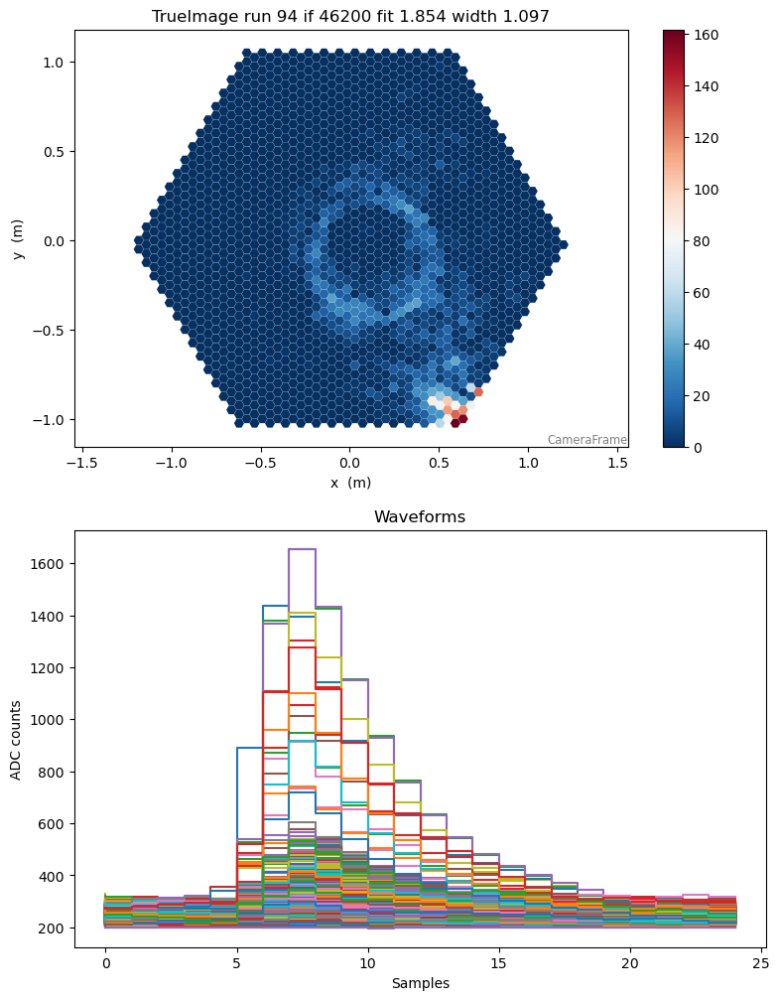

In [67]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
#filename = '/Users/vdk/MST_work/data_muons/mono_muon_simtel/muon_20deg_0deg_run0___cta-prod6-paranal-2147m-Paranal-0-LSTs-1-MSTs-0-SSTs-NSCAT_1_CSCAT_8_EMIN_0.005_EMAX_1_FIXCHI_600_VIEWCONE_3_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 20:
        event2 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="NeighborPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        #plt.savefig(f"/Users/vdk/MST_ProtonImages_NewQualityCheck/TrueImage+Waveform_mstPROTON_event{j.index.event_id}_obs{j.index.obs_id}_numer{i}")
        #plt.savefig(f"/Users/vdk/TrueImage+Waveform_mstMUON_event{j.index.event_id}_obs{j.index.obs_id}")
        break
        #if i == 150:
        #    break

plt.close()

TelescopeParameter type argument 'LST_*' did not match any known telescope types
TelescopeParameter type argument 'SST_1M_*' did not match any known telescope types


ImageExtractor
False
3825.1718140572475


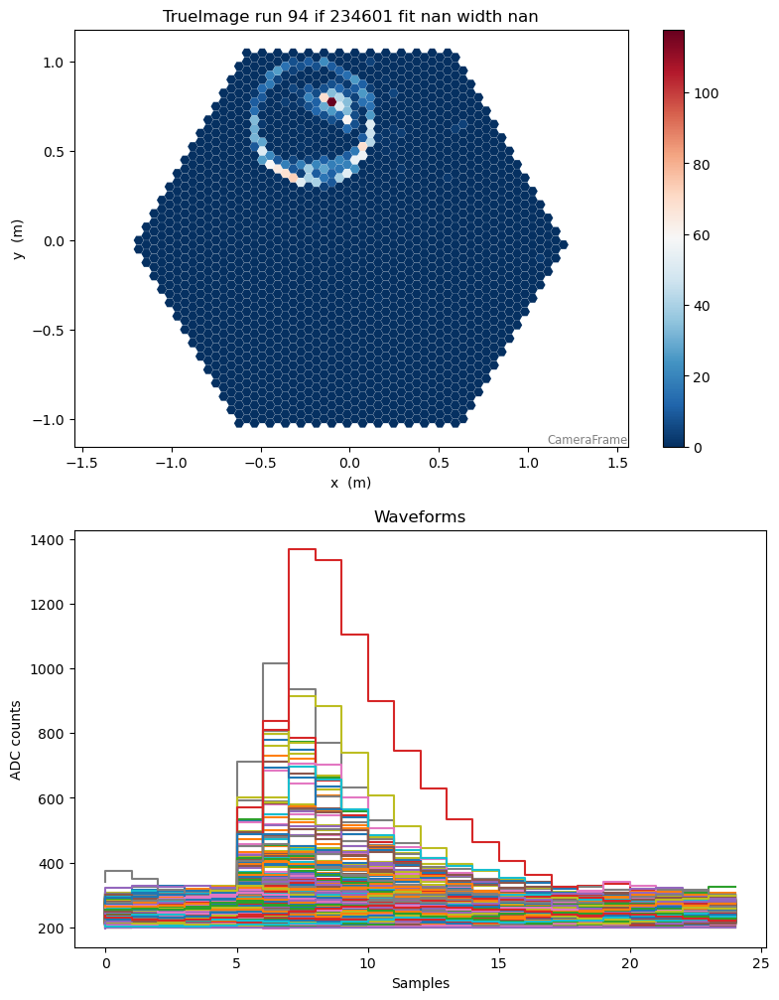

In [126]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
#filename = '/Users/vdk/MST_work/data_muons/mono_muon_simtel/muon_20deg_0deg_run0___cta-prod6-paranal-2147m-Paranal-0-LSTs-1-MSTs-0-SSTs-NSCAT_1_CSCAT_8_EMIN_0.005_EMAX_1_FIXCHI_600_VIEWCONE_3_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 112:
        event3 = j
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray)
        calib = CameraCalibrator(
                image_extractor_type="NeighborPeakWindowSum",
                subarray = source.subarray)
        calib(j)
        image_processor(j)
        muon_processor(j)
        fig, axes = plt.subplots(2, 1, sharex=False, gridspec_kw={'height_ratios': [1, 1]}, figsize=(9,12))
        fig.subplots_adjust(hspace=0.2)
        ax = axes[0]
        camgeom = source.subarray.tel[1].camera.geometry
        title="TrueImage run {} if {} fit {} width {}".format(j.index.obs_id, j.index.event_id, round(j.muon.tel[1].efficiency.optical_efficiency, 3), round(j.muon.tel[1].efficiency.width.to_value(),3))
        disp = CameraDisplay(camgeom,title=title, ax = ax)
        disp.image = j.simulation.tel[1].true_image #.sum(axis=1)
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        bx = axes[1]
        for pix_id in range(0,1764):
            bx.plot(j.r0.tel[1].waveform[0][pix_id], label="pix {}".format(pix_id), drawstyle='steps')
        bx.set_ylabel("ADC counts")
        bx.set_xlabel("Samples")
        bx.set_title("Waveforms")
        plt.show()
        #plt.savefig("/Users/vdk/TrueImage")
        #plt.savefig(f"/Users/vdk/MST_ProtonImages_NewQualityCheck/TrueImage+Waveform_mstPROTON_event{j.index.event_id}_obs{j.index.obs_id}_numer{i}")
        #plt.savefig(f"/Users/vdk/TrueImage+Waveform_mstMUON_event{j.index.event_id}_obs{j.index.obs_id}")
        break
        #if i == 150:
        #    break

plt.close()

44075


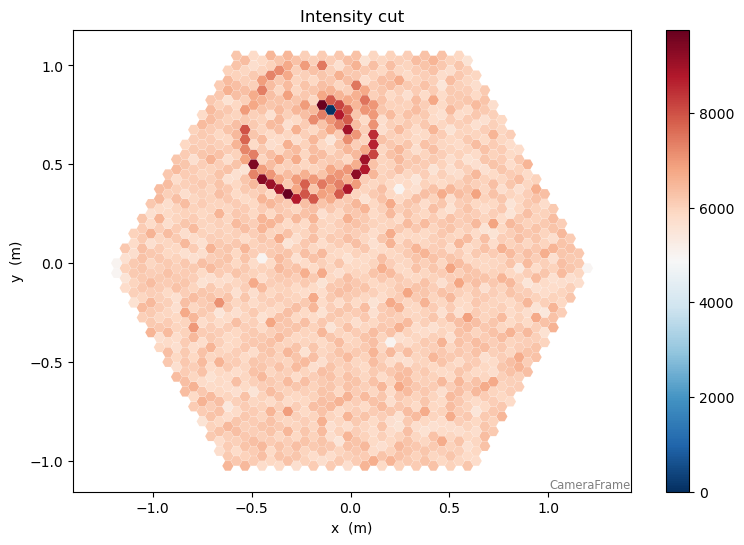

In [136]:
# check only pixels where signal is less then some value
# mean value for all pixels sum over the samples is 6200
work_arr = event3.r0.tel[1].waveform[0].copy()
work_arr[np.sum(work_arr, axis = 1) > 11000] = 0
print(np.count_nonzero(work_arr))
plt.figure(figsize = (9,6))
camgeom = source.subarray.tel[1].camera.geometry
title="Intensity cut"
disp = CameraDisplay(camgeom,title=title)
disp.image = work_arr.sum(axis=1)
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
#plt.savefig(f"/Users/vdk/IntensityCut_event{j.index.event_id}")

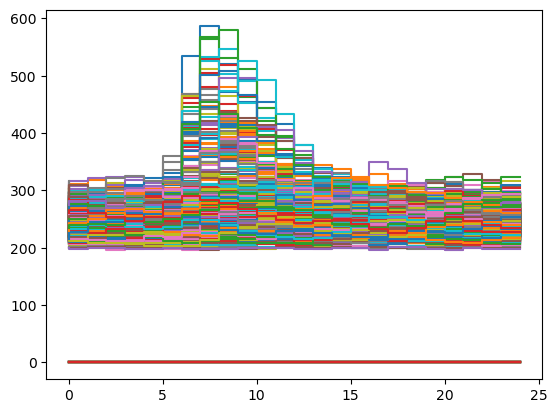

In [114]:
for pix_id in range(0,1764):
    plt.plot(work_arr[pix_id], label="pix {}".format(pix_id), drawstyle='steps')

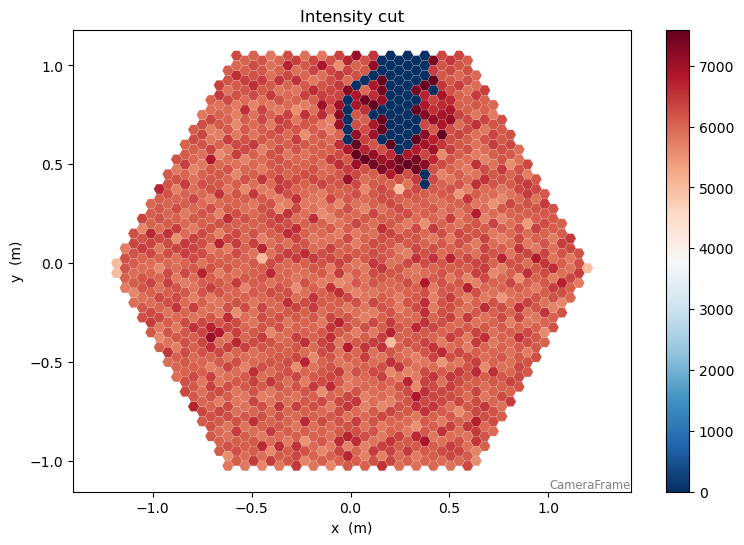

In [115]:
plt.figure(figsize = (9,6))
camgeom = source.subarray.tel[1].camera.geometry
title="Intensity cut"
disp = CameraDisplay(camgeom,title=title)
disp.image = work_arr.sum(axis=1)
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
#plt.savefig(f"/Users/vdk/IntensityCut_event{j.index.event_id}")

In [72]:
for i in work_arr:
    print(i)

[250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250
 250 250 250 250 250 250 250]
[247 265 279 288 292 288 296 326 330 316 300 284 266 253 256 261 266 268
 258 261 264 255 244 235 229]
[250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250
 250 250 250 250 250 250 250]
[250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250
 250 250 250 250 250 250 250]
[245 245 242 238 229 235 297 449 488 445 394 351 326 311 307 304 302 285
 275 279 276 264 251 252 257]
[244 237 238 240 238 244 326 480 515 469 416 382 353 333 310 289 275 267
 262 263 255 251 254 274 273]
[228 221 221 213 220 235 332 547 605 546 472 432 402 366 327 300 294 293
 278 261 249 241 232 227 221]
[255 257 259 266 275 284 304 349 356 339 316 299 289 277 269 257 248 257
 261 254 241 234 237 247 277]
[250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250 250
 250 250 250 250 250 250 250]
[241 237 242 252 255 254 255 257 248 252 263 264 259 254 250 255 255 249


In [73]:
print(min(np.sum(work_arr, axis = 1)))
print(max(np.sum(work_arr, axis = 1)))
print(np.mean(np.sum(work_arr, axis = 1)))

4976
7998
6196.89739229025


In [74]:
a = {1,2,3,4} 
b = {1,2,5,6}

In [75]:
a - b

{3, 4}

In [76]:
test = [i for i in range(0,1765)]

In [77]:
new_arr = set(test) - set(indices)

In [78]:
filename = '/Users/vdk/MST_work/data_muons/mono_proton_simtel/proton_20deg_0deg_run2___cta-prod6-paranal-2147m-Paranal-nshow-3000-0-LSTs-1-MSTs-0-SSTs-NSCAT_5_CSCAT_300_EMIN_1_EMAX_200_after_muontag.simtel.zst'
#filename = '/Users/vdk/MST_work/data_muons/mono_muon_simtel/muon_20deg_0deg_run0___cta-prod6-paranal-2147m-Paranal-0-LSTs-1-MSTs-0-SSTs-NSCAT_1_CSCAT_8_EMIN_0.005_EMAX_1_FIXCHI_600_VIEWCONE_3_after_muontag.simtel.zst'
source = EventSource(filename, max_events=9000)
event_iterator = iter(source)



for i,j in enumerate(event_iterator):
    if i == 92:
        event_work = j
        break

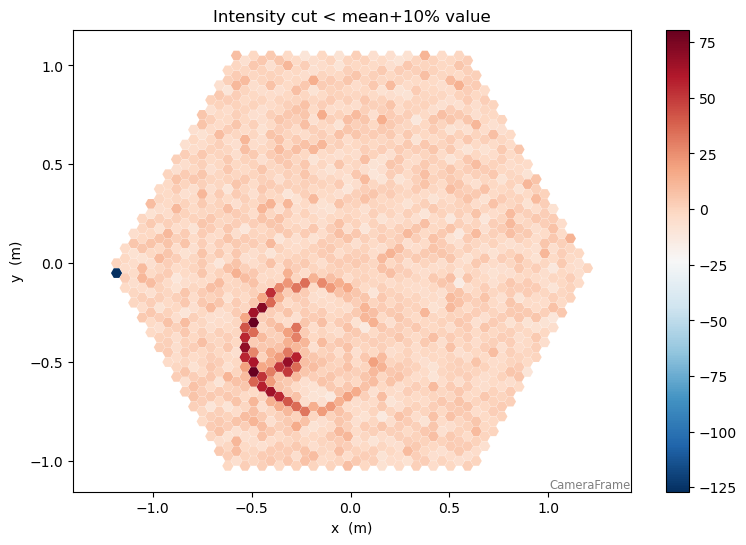

In [79]:
plt.figure(figsize = (9,6))
camgeom = source.subarray.tel[1].camera.geometry
title="Intensity cut < mean+10% value"
disp = CameraDisplay(camgeom,title=title)
disp.image = event.dl0.tel[1].waveform.sum(axis=1)
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)
#plt.savefig("/Users/vdk/IntensityCutMean+")


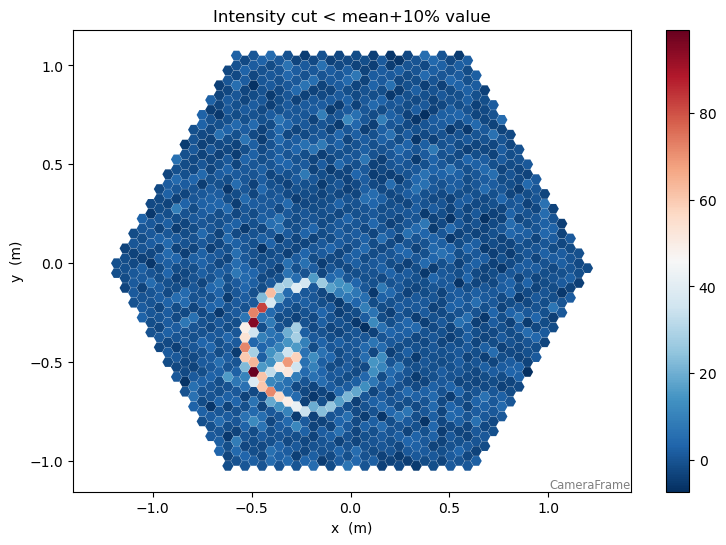

In [80]:
plt.figure(figsize = (9,6))
camgeom = source.subarray.tel[1].camera.geometry
title="Intensity cut < mean+10% value"
disp = CameraDisplay(camgeom,title=title)
disp.image = event.dl1.tel[1].image
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)


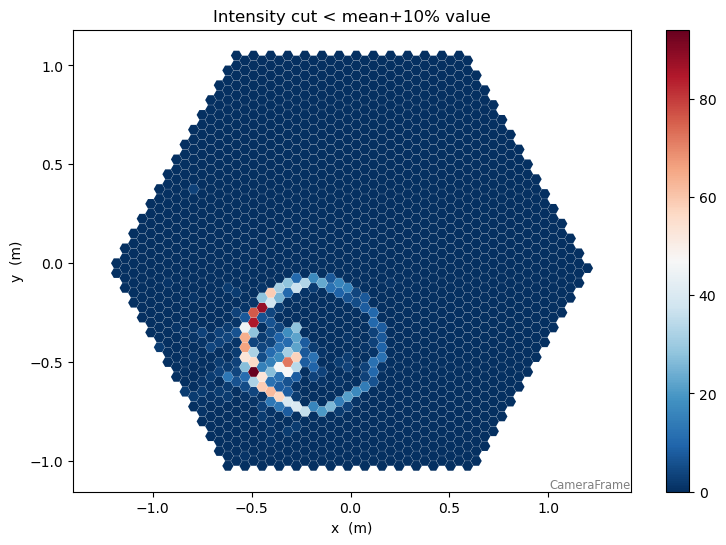

In [81]:
plt.figure(figsize = (9,6))
camgeom = source.subarray.tel[1].camera.geometry
title="Intensity cut < mean+10% value"
disp = CameraDisplay(camgeom,title=title)
disp.image = event.simulation.tel[1].true_image
#disp.image = true_image
disp.cmap = plt.cm.RdBu_r
disp.add_colorbar()
disp.set_limits_percent(95)

In [82]:
from ctapipe.image.extractor import ImageExtractor

image_extractors[name] = ImageExtractor.from_name(
                    name, subarray=self.subarray, parent=self
                )


dl1 = DL1CameraContainer(
                image=waveforms[..., 0].astype(np.float32),
                peak_time=np.zeros(n_pixels, dtype=np.float32),
                is_valid=True,
            )
extractor = self.image_extractors[self.image_extractor_type.tel[tel_id]]
dl1 = extractor(
                waveforms,
                tel_id=tel_id,
                selected_gain_channel=selected_gain_channel,
                broken_pixels=broken_pixels,
            )


NameError: name 'name' is not defined